Code for **super-resolution** (figures $1$ and $5$ from main paper).. Change `factor` to $8$ to reproduce images from fig. $9$ from supmat.

You can play with parameters and see how they affect the result. 

# Import libs

In [1]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import argparse
import os
import copy

import numpy as np
from models import *
from models.MaskGenNetwork import MaskGenNetwork
from models.MaskApplyNetworkLast import MaskApplyNetworkLast

import torch
import torch.optim

from skimage.measure import compare_psnr, compare_ssim, compare_mse
# from skimage.metrics import mean_squared_error

from models.downsampler import Downsampler

from utils.sr_utils import *

os.environ['CUDA_VISIBLE_DEVICES'] = '3'

torch.manual_seed(123)
np.random.seed(123)
# torch.backends.cudnn.deterministic = True
# torch.backends.cudnn.enabled = True
# torch.backends.cudnn.benchmark = False
dtype = torch.cuda.FloatTensor

imsize = -1 
factor = 4
enforse_div32 = 'CROP' # we usually need the dimensions to be divisible by a power of two (32 in this case)
PLOT = True


# Load image and baselines

HR and LR resolutions: (576, 384), (144, 96)


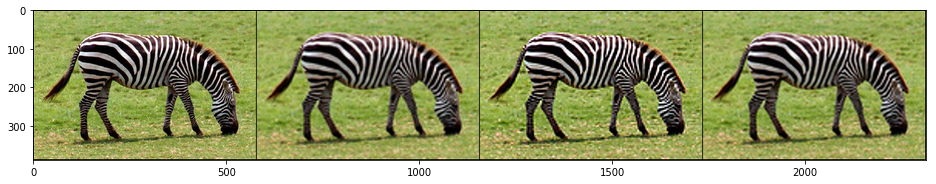

PSNR bicubic: 23.1048   PSNR lanczos: 23.5579
SSIM bicubic: 0.7930   SSIM lanczos: 0.8065


In [2]:
path_to_image = 'data/sr/zebra_GT.png'
# Starts here
imgs = load_LR_HR_imgs_sr(path_to_image , imsize, factor, enforse_div32)

imgs['bicubic_np'], imgs['sharp_np'], imgs['lanczos_np'] = get_baselines(imgs['LR_pil'], imgs['HR_pil'])

psnr_bicubic = compare_psnr(imgs['HR_np'], imgs['bicubic_np'])
psnr_lanczos = compare_psnr(imgs['HR_np'], imgs['lanczos_np'])
ssim_bicubic = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(imgs['bicubic_np'], (1, 2, 0)), multichannel=True)
ssim_lanczos = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(imgs['lanczos_np'], (1, 2, 0)), multichannel=True)

if PLOT:
    plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['sharp_np'], imgs['lanczos_np']], 4,12);
    print ('PSNR bicubic: %.4f   PSNR lanczos: %.4f' %  (psnr_bicubic, psnr_lanczos))
    print ('SSIM bicubic: %.4f   SSIM lanczos: %.4f' %  (ssim_bicubic, ssim_lanczos))

# Set up parameters and net

In [3]:
input_depth = 32
 
INPUT =     'noise'
pad   =     'reflection'
OPT_OVER =  'net'
KERNEL_TYPE='lanczos2'

if factor == 4: 
    num_iter = 2500
    reg_noise_std = 0.03
elif factor == 8:
    num_iter = 4000
    reg_noise_std = 0.05
else:
    assert False, 'We did not experiment with other factors'

In [4]:
net_input_1 = get_noise(input_depth, INPUT, (imgs['HR_pil'].size[1], imgs['HR_pil'].size[0])).type(dtype).detach()

net = MaskApplyNetworkLast(num_input_channels=32,
                           num_output_channels=3,
                           num_channels_down=[128, 128, 128, 128, 128],
                           num_channels_up=[128, 128, 128, 128, 128],
                           act_fun='ReLU').type(dtype)

net = net.cuda()
init_weights = net.state_dict()
init_weights_copy = copy.deepcopy(init_weights)

mask_net = MaskGenNetwork(n_residual_blocks=12,
                          sr_factor=factor,
                          out_channels=128,
                          up_channels = 128,
                          half_scale=1).type(dtype)


mask_net = mask_net.cuda()


In [5]:
# Losses
mse = torch.nn.MSELoss().type(dtype)

img_LR_var = np_to_torch(imgs['LR_np']).type(dtype)
img_LR_var_clone = img_LR_var.clone().detach()
img_HR_var = np_to_torch(imgs['HR_np']).type(dtype)

downsampler = Downsampler(n_planes=3, factor=factor, kernel_type=KERNEL_TYPE, phase=0.5, preserve_size=True).type(dtype)

# Define closure and optimize

In [6]:
def closure():
    global i, net_input_1
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

    mask_1 = mask_net(img_LR_var_clone)
    mask_binary_1 = mask_1 > 0.5
    mask_binary_1 = mask_binary_1.float()
    
    mask_binary_1.requires_grad = True
    
    out_HR = net(net_input, mask_binary_1)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var)
    total_loss.backward()

    mask_1.backward(mask_binary_1.grad)

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
    mse_HR = compare_mse(imgs['HR_np'], torch_to_np(out_HR))
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 50 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        mse_history.append(mse_HR)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

In [7]:
psnr_history = []
mse_history = []
ssim_history = []
iter_history = []
loss_history = []

net_input_saved = net_input_1.detach().clone()
noise = net_input_1.detach().clone()

i = 0

dip_params = get_params(OPT_OVER, net, net_input_1)
mask_params = get_params(OPT_OVER, mask_net, net_input_1)

# for a in net.named_parameters():
#     print(a[0])
# print('------------------')
# for a in mask_net.named_parameters():
#     print(a[0])
# mask.requires_grad = True

/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1350: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2390: UserWarning: nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.
  warnings.warn("nn.functional.upsample is deprecated. Use nn.functional.interpolate instead.")
/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:2479: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


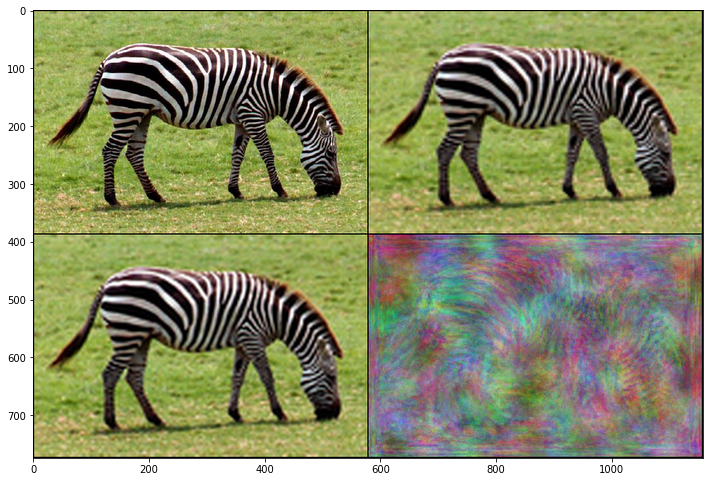

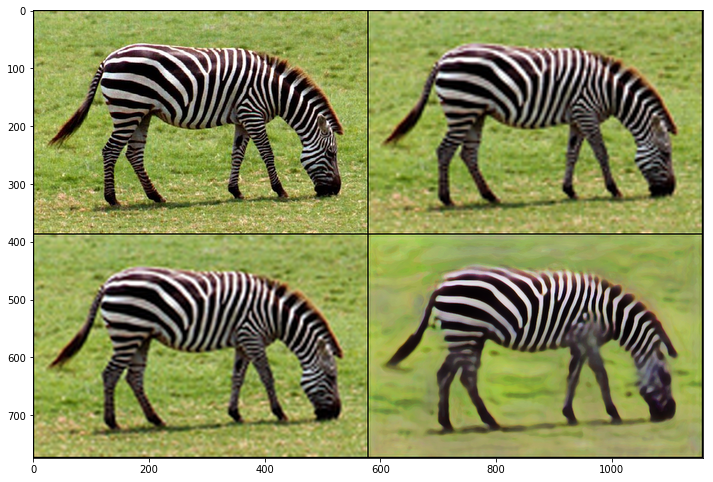

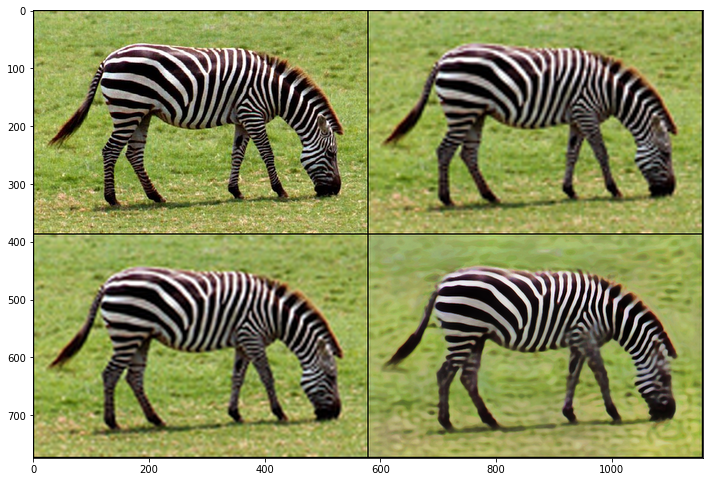

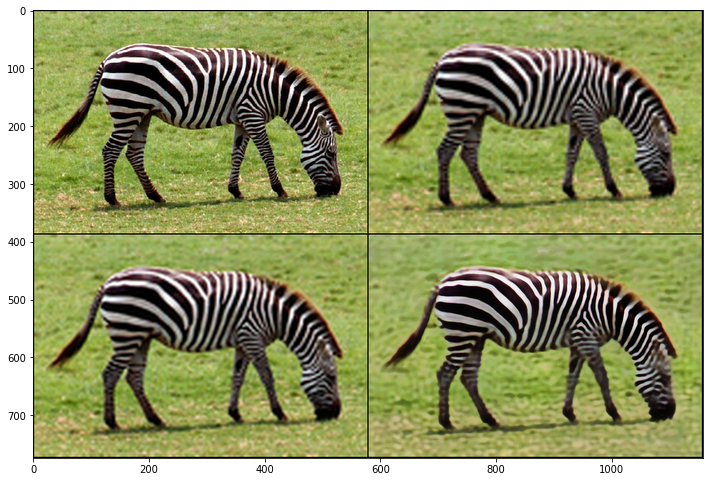

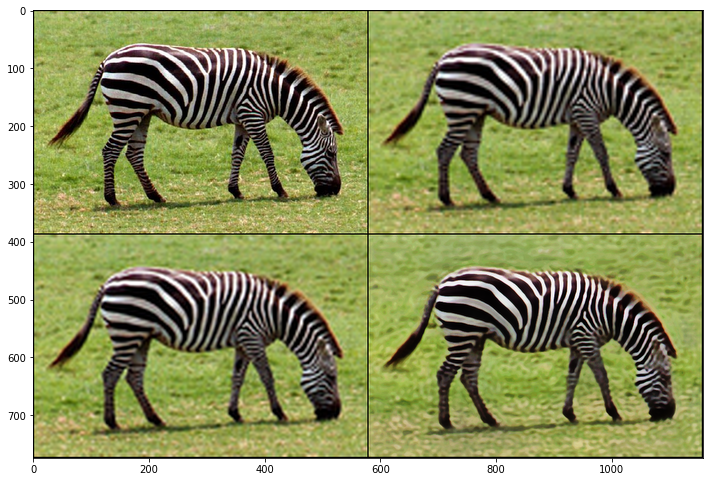

...

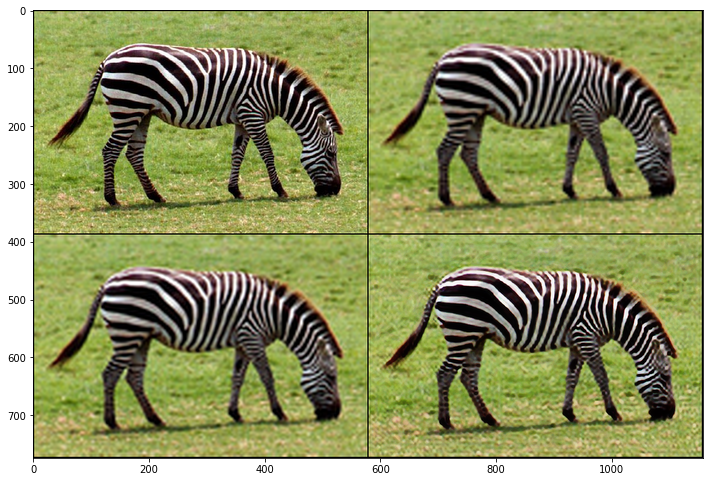

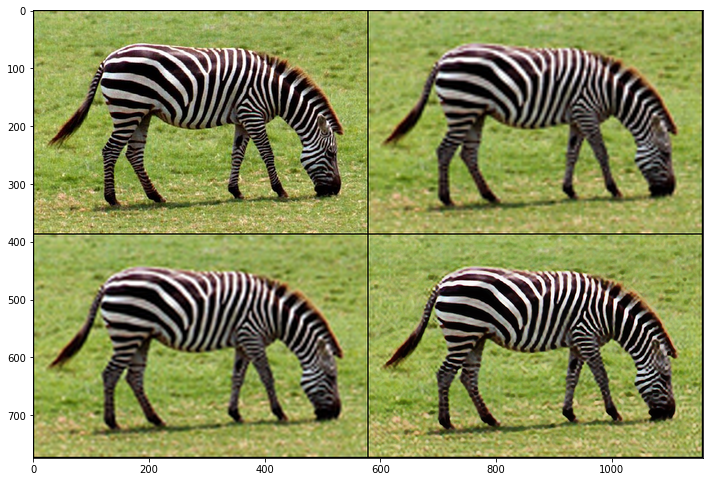

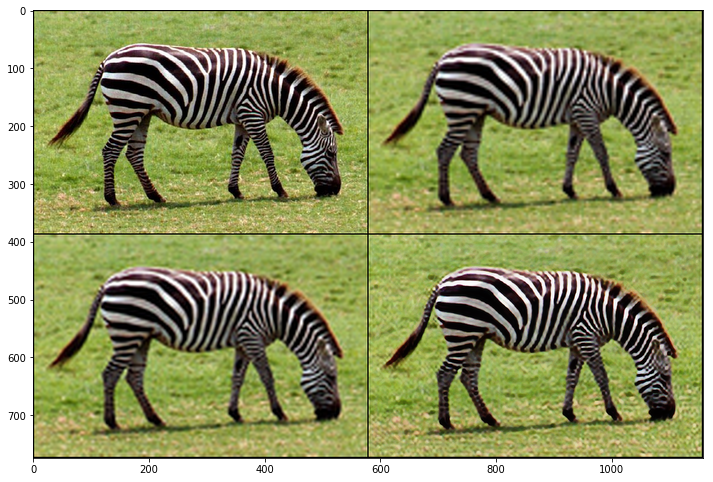

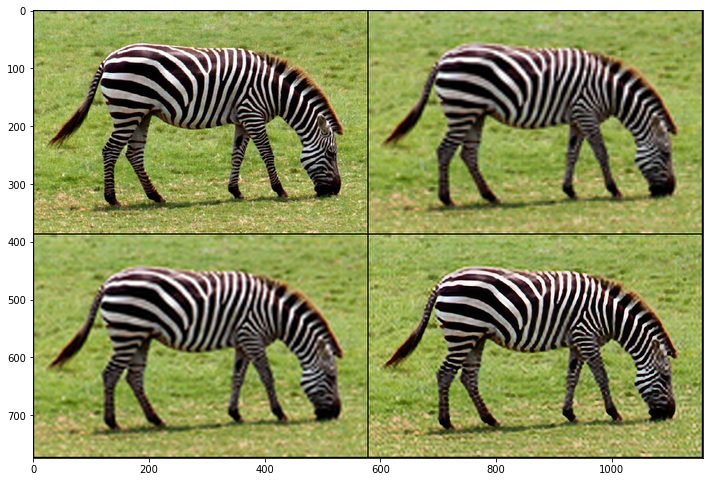

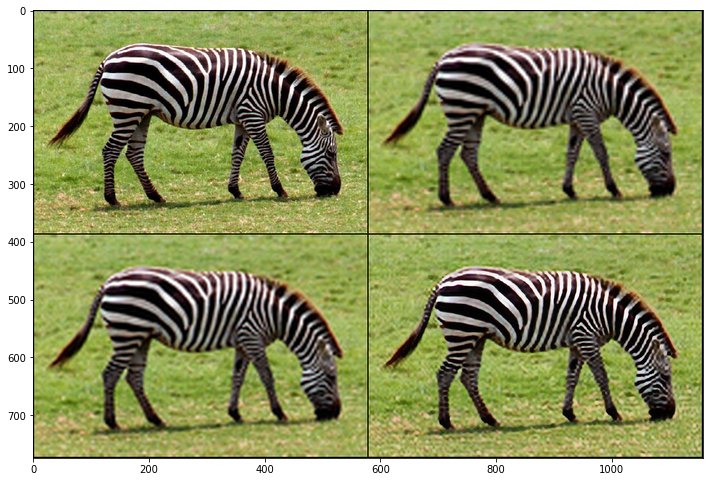

In [8]:
optimizer = torch.optim.Adam([{'params': dip_params, 'lr': 0.001},
                             {'params': mask_params, 'lr': 0.001}])
# parameters = dip_params + mask_params


for j in range(num_iter):
    optimizer.zero_grad()
    closure()
    optimizer.step()

In [9]:
mask_1 = mask_net(img_LR_var_clone)
mask_binary_1 = mask_1 > 0.5
mask_binary = mask_binary_1.cpu().numpy()

/home/anuj/anaconda3/lib/python3.6/site-packages/torch/nn/functional.py:1350: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


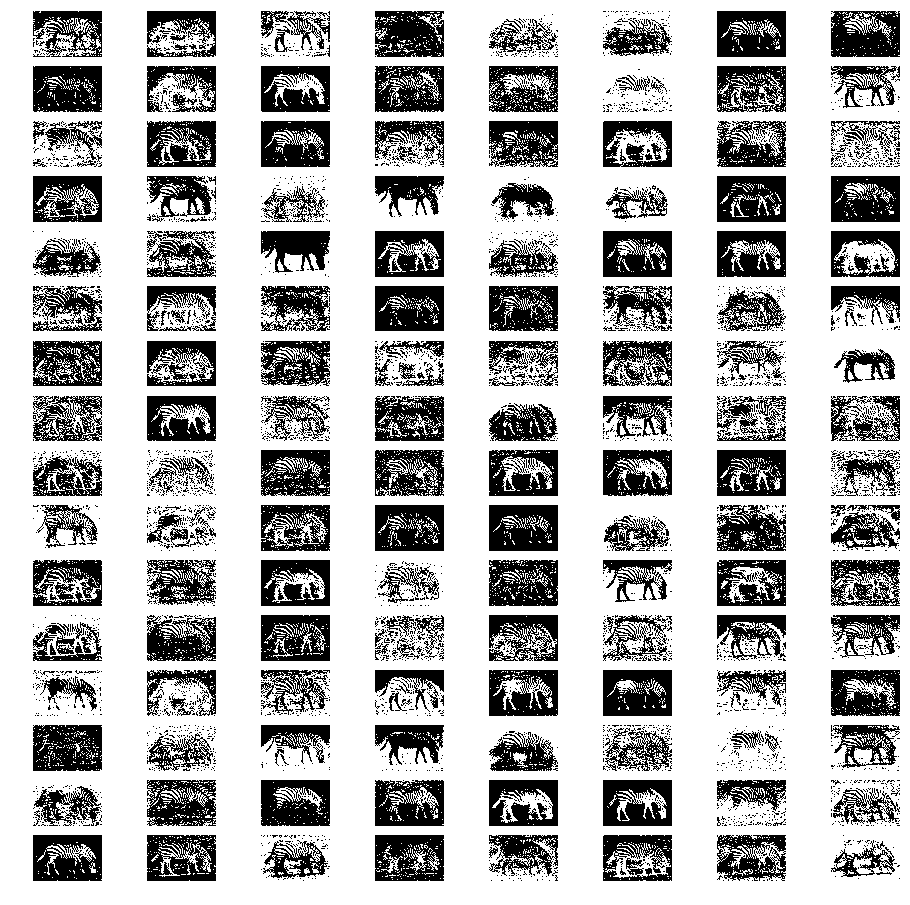

In [11]:
# Visualize Masks
plt.figure(figsize=(16, 16))
for i in range(128):
    plt.subplot(16, 8, i+1)
    plt.imshow(mask_binary[0, i, :, :], cmap='gray')
    plt.axis('off')

(3, 384, 576)


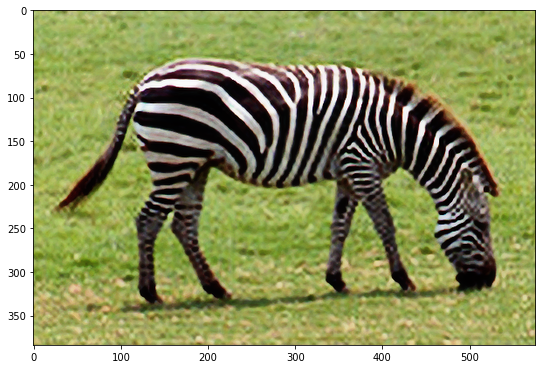

/home/anuj/anaconda3/lib/python3.6/site-packages/skimage/util/dtype.py:122: UserWarning: Possible precision loss when converting from float32 to uint8
  .format(dtypeobj_in, dtypeobj_out))


In [20]:
# out_HR = net(net_input_1, mask_binary_1.float())
# psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
# mse_HR = compare_mse(imgs['HR_np'], torch_to_np(out_HR))
    
# ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)

# print("PSNR: ", psnr_HR)
# print("SSIM: ", ssim_HR)
# print("MSE: ", mse_HR)

out_HR_np = np.clip(torch_to_np(out_HR), 0, 1)
print(out_HR_np.shape)
plot_image_grid([out_HR_np], factor=8, nrow=1)

# Save image
file_path = 'data/sr/zebra_4x.png'
import skimage.io as sio
sio.imsave(file_path, np.transpose(out_HR_np, (1, 2, 0)))

In [ ]:
from scipy import ndimage

In [ ]:
struct = ndimage.generate_binary_structure(2, 1)
print(struct)

In [ ]:
mask_opened = np.copy(mask_binary)
mask_closed = np.copy(mask_binary)
for i in range(mask_binary.shape[1]):
    mask_opened[0, i, :, :] = snm.binary_opening(mask_binary[0, i, :, :], struct, iterations=1)
    mask_closed[0, i, :, :] = snm.binary_closing(mask_binary[0, i, :, :], struct, iterations=1)

In [ ]:
mask_closed_tensor = torch.tensor(mask_closed).float().cuda()
mask_closed_tensor.requires_grad = True
mask_opened_tensor = torch.tensor(mask_opened).float().cuda()
mask_opened_tensor.requires_grad = True


In [ ]:
def closure2():
    global i, net_input_saved, mask_closed_tensor
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

#     out_HR = net(net_input)
    out_HR = net2(net_input, mask_closed_tensor)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     if psnr_HR > max_psnr:
#         max_psnr = psnr_HR
#         best_dict = copy.deepcopy(net.state_dict())
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
#     ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   Loss %.6f' % (i, psnr_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 50 == 0):
        psnr_history.append(psnr_HR)
#         ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
#         plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

def closure3():
    global i, net_input_saved, mask_opened_tensor
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

#     out_HR = net(net_input)
    out_HR = net3(net_input, mask_opened_tensor)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     if psnr_HR > max_psnr:
#         max_psnr = psnr_HR
#         best_dict = copy.deepcopy(net.state_dict())
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
#     ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   Loss %.6f' % (i, psnr_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 50 == 0):
        psnr_history.append(psnr_HR)
#         ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
#         plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

In [ ]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []
net_input_saved = net_input_1.detach().clone()
noise = net_input_1.detach().clone()

i = 0
num_iter = 2000
p = get_params(OPT_OVER, net2, net_input_1)
optimize(OPTIMIZER, p, closure2, 0.001, num_iter)

In [ ]:
plt.plot(iter_history, psnr_history)

In [ ]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []
net_input_saved = net_input_1.detach().clone()
noise = net_input_1.detach().clone()

i = 0
num_iter = 2000
net3.load_state_dict(init_weights_copy)
p = get_params(OPT_OVER, net3, net_input_1)
optimize(OPTIMIZER, p, closure3, 0.001, num_iter)

In [ ]:
# net.load_state_dict(best_dict)
output, mask_arr = net(net_input_1, mask_array)
psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(output))
print("PSNR: ", psnr_HR)
out_HR_np = np.clip(torch_to_np(output), 0, 1)

plot_image_grid([out_HR_np], factor=8, nrow=1)

In [ ]:
plt.plot(iter_history, psnr_history)

In [ ]:
plt.plot(iter_history, ssim_history)

In [ ]:
mask_1 = mask_net(img_LR_var_clone)
mask_binary_1 = mask_1 > 0.5
mask_binary_1 = mask_binary_1.cpu().numpy()
print(mask_binary_1.shape)


# mask_binary_1 = mask_binary_1.float()

In [ ]:
# plt.imshow(mask_binary_1[0, 12, :, :], cmap='gray')
# plt.axis('off')
plt.figure(figsize=(16, 16))
for i in range(128):
    plt.subplot(16, 8, i+1)
    plt.imshow(mask_binary_1[0, i, :, :], cmap='gray')
    plt.axis('off')

In [ ]:
def closure2():
    global i, net_input_1, max_psnr, best_dict, mask_arr
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

#     out_HR = net(net_input)
#     if (i % 100) == 1:
#         out_HR, mask_array = net(net_input, mask_array, mask_mode=True)
#     else:
    out_HR, mask_array = net2(net_input, mask_arr, mask_mode=True)
    
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var)    
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 100 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

In [ ]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []

i = 0
# num_iter = 4000
# max_psnr = 0
# best_dict = init_weights
p = get_params(OPT_OVER, net2, net_input_1)
optimize(OPTIMIZER, p, closure2, LR, num_iter)

In [ ]:
plt.plot(iter_history, psnr_history)

In [ ]:
net2.load_state_dict(best_dict)
output_2, mask_arr_2 = net2(net_input_1)
psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(output_2))
print("PSNR: ", psnr_HR)
out_HR_np = np.clip(torch_to_np(output_2), 0, 1)

plot_image_grid([out_HR_np], factor=8, nrow=1)

In [ ]:
print(mask_arr[0].shape, mask_arr_2[0].shape)

In [ ]:
plt.imshow(mask_arr[0].cpu().numpy()[0, 1], cmap='gray')
plt.colorbar()

In [ ]:
plt.imshow(mask_arr_2[0].cpu().numpy()[0, 1], cmap='gray')
plt.colorbar()

In [ ]:
# Conv1
conv_a = mask_arr[0][0, :, :, :].cpu().numpy()
conv_b = mask_arr_2[0][0, :, :, :].cpu().numpy()
eq = (conv_a == conv_b)
# plt.imshow(eq[0], cmap='gray')
plt.figure(figsize=(16, 16))
for i in range(128):
    plt.subplot(16, 8, i+1)
    plt.imshow(eq[i], cmap='gray')
    plt.axis('off')
    

In [ ]:
# Conv2
conv_a = mask_arr[1][0, :, :, :].cpu().numpy()
conv_b = mask_arr_2[1][0, :, :, :].cpu().numpy()
eq = (conv_a == conv_b)
# plt.imshow(eq[0], cmap='gray')
plt.figure(figsize=(16, 16))
for i in range(128):
    plt.subplot(16, 8, i+1)
    plt.imshow(eq[i], cmap='gray')
    plt.axis('off')

In [ ]:
# Conv 3
j = 23
conv_a = mask_arr[j][0, :, :, :].cpu().numpy()
conv_b = mask_arr_2[j][0, :, :, :].cpu().numpy()
eq = (conv_a == conv_b)
# plt.imshow(eq[0], cmap='gray')
plt.figure(figsize=(16, 16))
for i in range(mask_arr[j].shape[1]):
    plt.subplot(16, 8, i+1)
    plt.imshow(eq[i], cmap='gray')
    plt.axis('off')

In [ ]:
print(best_dict)

In [ ]:
psnr_history_1 = psnr_history.copy()

In [ ]:
plt.plot(iter_history, loss_history)

In [ ]:
plt.plot(iter_history, psnr_history)

In [ ]:
output = net2(net_input_2, mask_arr)
psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(output))
print("PSNR: ", psnr_HR)
out_HR_np = np.clip(torch_to_np(output), 0, 1)

plot_image_grid([out_HR_np], factor=8, nrow=1)

In [ ]:
def closure3():
    global i, net_input_2

#     out_HR = net(net_input)
    out_HR = net3(net_input_2, mask_arr)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
    
    if tv_weight > 0:
        total_loss += tv_weight * tv_loss(out_HR)
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 50 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

In [ ]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []

i = 0
num_iter = 1000
p = get_params(OPT_OVER, net3, net_input_2)
optimize(OPTIMIZER, p, closure3, LR, num_iter)

In [ ]:
psnr_history_2 = psnr_history.copy()

In [ ]:
plt.plot(iter_history, loss_history)

In [ ]:
plt.plot(iter_history, psnr_history)

In [ ]:
def closure4():
    global i, net_input_3
    
#     out_HR = net(net_input)
    out_HR = net4(net_input_3, mask_arr)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
    
    if tv_weight > 0:
        total_loss += tv_weight * tv_loss(out_HR)
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 50 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

In [ ]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []

i = 0
num_iter = 1000
p = get_params(OPT_OVER, net4, net_input_3)
optimize(OPTIMIZER, p, closure4, LR, num_iter)

In [ ]:
psnr_history_3 = psnr_history.copy()

In [ ]:
plt.plot(iter_history, psnr_history_1, 'b', iter_history, psnr_history_2, 'r', iter_history, psnr_history_3, 'g')

In [ ]:
net5 = SkipMaskApply(num_input_channels=32,
               num_output_channels=3,
               num_channels_down=[128, 128, 128, 128, 128],
               num_channels_up=[128, 128, 128, 128, 128],
               act_fun='ReLU').type(dtype)

net5 = net5.cuda()

In [ ]:
def closure5():
    global i, net_input_1
    
#     out_HR = net(net_input)
    out_HR = net5(net_input_1, mask_arr)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 50 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

In [ ]:
psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []

i = 0
num_iter = 1000
p = get_params(OPT_OVER, net5, net_input_1)
optimize(OPTIMIZER, p, closure5, LR, num_iter)

In [ ]:
psnr_history_w_1 = psnr_history.copy()

In [ ]:
net6 = SkipMaskApply(num_input_channels=32,
               num_output_channels=3,
               num_channels_down=[128, 128, 128, 128, 128],
               num_channels_up=[128, 128, 128, 128, 128],
               act_fun='ReLU').type(dtype)

net6 = net6.cuda()

net7 = SkipMaskApply(num_input_channels=32,
               num_output_channels=3,
               num_channels_down=[128, 128, 128, 128, 128],
               num_channels_up=[128, 128, 128, 128, 128],
               act_fun='ReLU').type(dtype)

net7 = net7.cuda()

print(net6.state_dict()['conv1_1.1.weight'][0])
print(net7.state_dict()['conv1_1.1.weight'][0])

In [ ]:
def closure6():
    global i, net_input_1
    
#     out_HR = net(net_input)
    out_HR = net6(net_input_1, mask_arr)
    out_LR = downsampler(out_HR)

    total_loss = mse(out_LR, img_LR_var) 
        
    total_loss.backward()

    # Log
#     psnr_LR = compare_psnr(imgs['LR_np'], torch_to_np(out_LR))
    psnr_HR = compare_psnr(imgs['HR_np'], torch_to_np(out_HR))
#     print ('Iteration %05d    PSNR_LR %.3f   PSNR_HR %.3f' % (i, psnr_LR, psnr_HR), '\r', end='')
    
    ssim_HR = compare_ssim(np.transpose(imgs['HR_np'], (1, 2, 0)), np.transpose(torch_to_np(out_HR), (1, 2, 0)), multichannel=True)
    print ('Iteration %05d    PSNR_HR %.3f   SSIM_HR %.3f   Loss %.6f' % (i, psnr_HR, ssim_HR, total_loss.data), '\r', end='')
    
    if PLOT and (i % 50 == 0):
        psnr_history.append(psnr_HR)
        ssim_history.append(ssim_HR)
        iter_history.append(i)
        loss_history.append(total_loss.data)
        out_HR_np = torch_to_np(out_HR)
        plot_image_grid([imgs['HR_np'], imgs['bicubic_np'], imgs['lanczos_np'], np.clip(out_HR_np, 0, 1)], factor=8, nrow=2)

    i += 1
    
    return total_loss

psnr_history = []
rmse_history = []
ssim_history = []
iter_history = []
loss_history = []

i = 0
num_iter = 1000
p = get_params(OPT_OVER, net6, net_input_1)
optimize(OPTIMIZER, p, closure6, LR, num_iter)